In [3]:
import numpy as np
import pandas as pd
import os
import cv2
from tqdm import tqdm
import glob
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.image as mpimg
import random
from imageio import imsave

In [4]:
from skimage.feature import hog
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.externals import joblib
from sklearn import svm
from sklearn.model_selection import GridSearchCV
from scipy.ndimage.measurements import label

In [5]:
from util import *

# Data

In [6]:
data_dir = 'data'

## Project Video 

In [8]:
output_dir = 'output_images' 
project_video_file = 'project_video.mp4'

In [6]:
extract_video_imgs(project_video_file, output_dir)

 99%|█████████████████████████████████████████████████████████████████████████████▎| 1248/1259 [00:23<00:00, 52.77it/s]

In [9]:
project_img_files = sorted(glob.glob('%s/*.jpg' % output_dir))
sample_project_imgs = read_imgs(project_img_files[:10], scale_to_255=False)

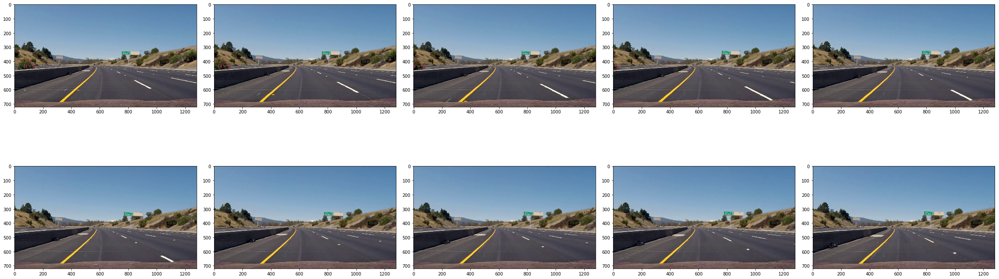

In [8]:
display_images(sample_project_imgs, figsize=(32,16))

In [9]:
sample_project_imgs.min(), sample_project_imgs.max()

(0, 255)

## Test Video

In [10]:
test_output_dir = 'test_images2' 
test_video_file = 'test_video.mp4'

In [11]:
extract_video_imgs(test_video_file, test_output_dir)


 68%|███████████████████████████████████████████████████████▍                          | 25/37 [00:00<00:00, 46.64it/s]

In [12]:
test_img_files = sorted(glob.glob('%s/*.jpg' % test_output_dir))[:10]
sample_test_imgs = read_imgs(test_img_files, scale_to_255=False)

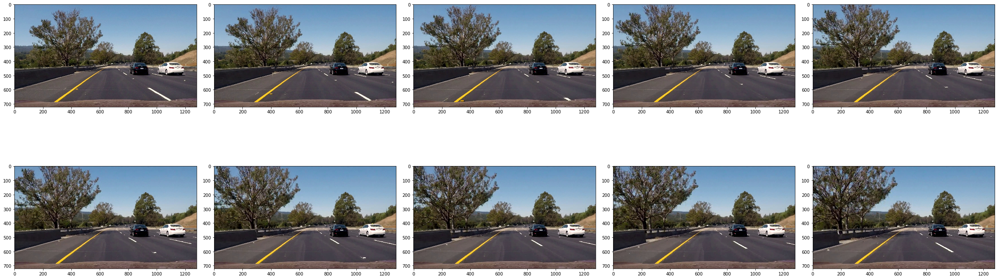

In [13]:
display_images(sample_test_imgs, figsize=(32,16))

In [14]:
sample_test_imgs.min(), sample_test_imgs.max()

(0, 255)

## Vehicle/Not Vehicle

### Vehicle

In [233]:
vehicle_dir = '%s/vehicles' % data_dir
vehicle_img_files = sorted(glob.glob('%s/*/*.png' % vehicle_dir))
vehicle_imgs = read_imgs(vehicle_img_files, scale_to_255=True)

In [234]:
len(vehicle_imgs)

8792

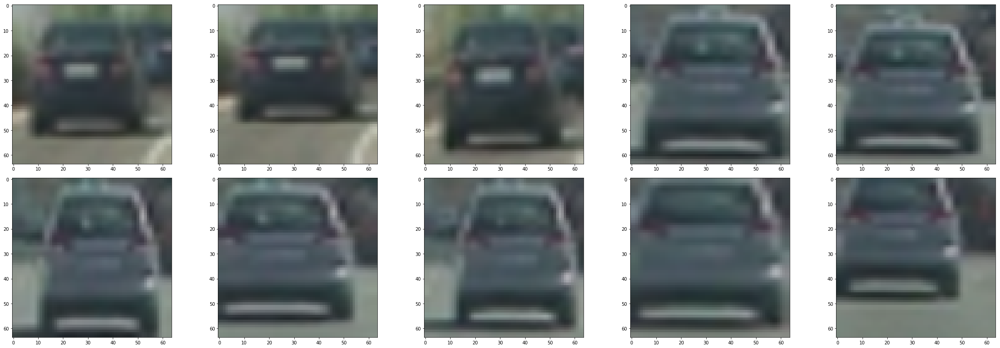

In [235]:
display_images(vehicle_imgs[:10], figsize=(32,16))

In [236]:
vehicle_imgs[0].min(), vehicle_imgs[0].max()

(33, 192)

### Non-Vehicle

In [237]:
non_vehicle_dir = '%s/non-vehicles' % data_dir
non_vehicle_img_files = sorted(glob.glob('%s/*/*.png' % non_vehicle_dir))
non_vehicle_imgs = read_imgs(non_vehicle_img_files, scale_to_255=True)

In [238]:
len(non_vehicle_imgs)

8968

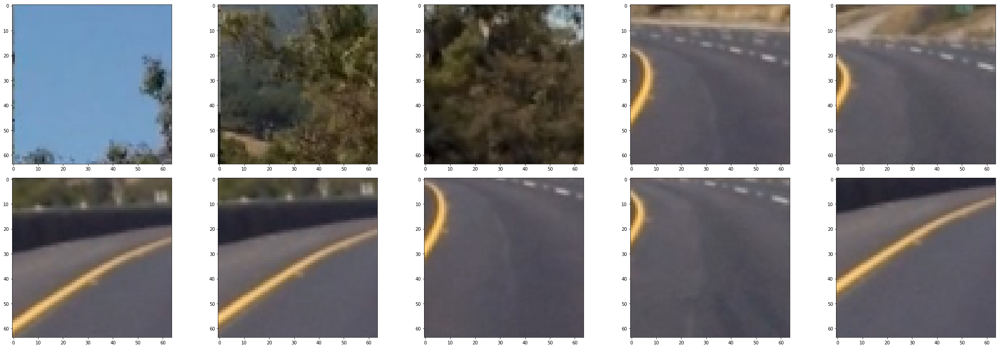

In [239]:
display_images(non_vehicle_imgs[:10], figsize=(32,16))

In [240]:
non_vehicle_imgs[0].min(), non_vehicle_imgs[0].max()

(4, 207)

## Train, Val, Test

In [241]:
X_img_files = vehicle_img_files + non_vehicle_img_files
y = [1.0]*len(vehicle_img_files) + [0.0]*len(non_vehicle_img_files)

In [242]:
X_train_imgs_filename = '%s/X_train_imgs.csv' % data_dir
X_val_imgs_filename = '%s/X_val_imgs.csv' % data_dir
X_test_imgs_filename = '%s/X_test_imgs.csv' % data_dir
y_train_filename = '%s/y_train.csv' % data_dir
y_val_filename = '%s/y_val.csv' % data_dir
y_test_filename = '%s/y_test.csv' % data_dir

In [243]:
if not do_files_exists([X_train_imgs_filename, X_val_imgs_filename, X_test_imgs_filename, 
                       y_train_filename, y_val_filename, y_test_filename]):
    X_train_img_files, X_test_img_files, y_train, y_test = train_test_split(X_img_files, y, test_size=0.3, 
                                                                            random_state=5150)
    X_val_img_files, X_test_img_files, y_val, y_test = train_test_split(X_test_img_files, y_test, test_size=0.33,
                                                                    random_state=5150)
    assert len(X_train_img_files) + len(X_val_img_files) + len(X_test_img_files) == len(X_img_files)
    assert len(y_train) + len(y_val) + len(y_test) == len(y)    
    
    save_img_file_csv(X_train_img_files, X_train_imgs_filename)
    save_img_file_csv(X_val_img_files, X_val_imgs_filename)
    save_img_file_csv(X_test_img_files, X_test_imgs_filename)
    save_label_file_csv(y_train, y_train_filename)
    save_label_file_csv(y_val, y_val_filename)
    save_label_file_csv(y_test, y_test_filename)
else:
    X_train_img_files = read_img_file_csv(X_train_imgs_filename)
    X_val_img_files = read_img_file_csv(X_val_imgs_filename)
    X_test_img_files = read_img_file_csv(X_test_imgs_filename)
    y_train = read_label_file_csv(y_train_filename)
    y_val = read_label_file_csv(y_val_filename)
    y_test = read_label_file_csv(y_test_filename)

In [244]:
X_train_vehicle_files = []
X_train_nonvehicle_files = []

for i, curr_y in enumerate(y_train):
    if curr_y == 0.0:
        X_train_nonvehicle_files.append(X_train_img_files[i])
    else:
        X_train_vehicle_files.append(X_train_img_files[i])

In [245]:
len(X_train_nonvehicle_files), len(X_train_vehicle_files)

(6251, 6181)

## Train Vehicles

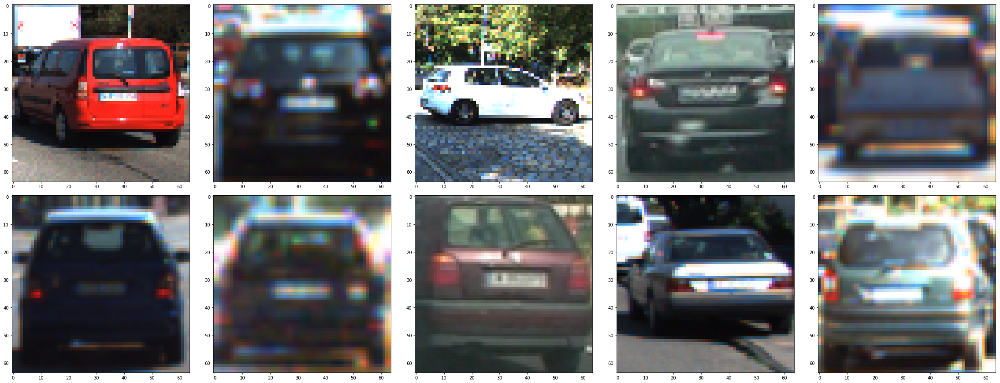

In [246]:
display_images(X_train_vehicle_files, start_idx=0, end_idx=10,  step_val=1,
                   columns = 5, use_gray=False,
                   apply_fnc=lambda x: read_img(x, scale_to_255=True), figsize=(32,18))

## Train Nonvehicles

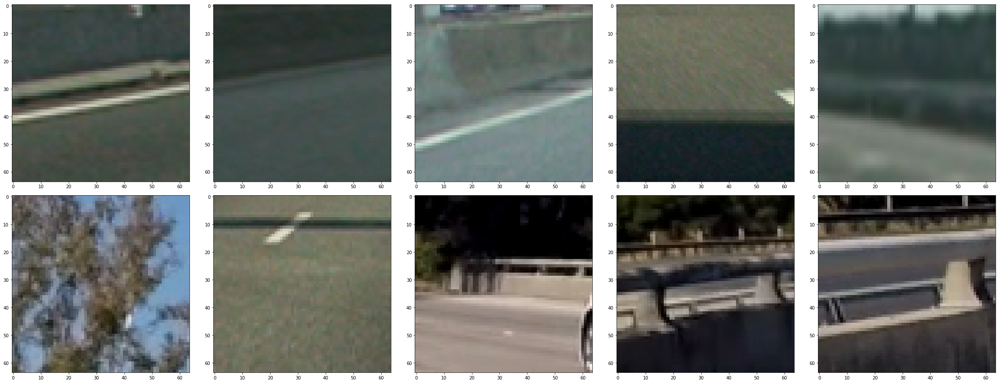

In [247]:
display_images(X_train_nonvehicle_files, start_idx=0, end_idx=10,  step_val=1,
                   columns = 5, use_gray=False,
                   apply_fnc=lambda x: read_img(x, scale_to_255=True), figsize=(32,18))

# Color Histogram

In [248]:
def color_hist(img, nbins=32, bins_range=(0, 256)):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins, range=bins_range)
    channel2_hist = np.histogram(img[:,:,1], bins=nbins, range=bins_range)
    channel3_hist = np.histogram(img[:,:,2], bins=nbins, range=bins_range)
    
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    
    # Return the individual histograms, bin_centers and feature vector
    return hist_features

In [249]:
img = read_img(X_train_vehicle_files[0], scale_to_255=True)

In [251]:
feature_vec = color_hist(img, nbins=32, bins_range=(0, 256))
feature_vec

array([  4, 310, 225, 195, 252, 225, 222, 173, 174, 135,  94,  63, 119,
       127, 144, 114, 102,  90,  69,  86,  86,  65,  51,  45,  34,  33,
        32,  46,  39,  29,  54, 659,  10, 335, 276, 302, 426, 416, 257,
       214, 196, 139, 119, 114, 136, 181, 120,  84,  89,  54,  59,  52,
        54,  27,  28,  19,  16,  12,  25,   8,  18,  11,  13, 286,   0,
       265, 440, 586, 327, 198, 186, 159, 146, 129, 140, 185, 190, 197,
       128, 102,  71,  63,  56,  34,  34,  21,  18,  15,  16,   9,  10,
         7,  11,  23,  15, 315], dtype=int64)

# Color Spaces

In [252]:
def plot3d(pixels, colors_rgb,
        axis_labels=list("RGB"), axis_limits=((0, 255), (0, 255), (0, 255))):
    """Plot pixels in 3D."""

    # Create figure and 3D axes
    fig = plt.figure(figsize=(8, 8))
    ax = Axes3D(fig)

    # Set axis limits
    ax.set_xlim(*axis_limits[0])
    ax.set_ylim(*axis_limits[1])
    ax.set_zlim(*axis_limits[2])

    # Set axis labels and sizes
    ax.tick_params(axis='both', which='major', labelsize=14, pad=8)
    ax.set_xlabel(axis_labels[0], fontsize=16, labelpad=16)
    ax.set_ylabel(axis_labels[1], fontsize=16, labelpad=16)
    ax.set_zlabel(axis_labels[2], fontsize=16, labelpad=16)

    # Plot pixel values with colors given in colors_rgb
    ax.scatter(
        pixels[:, :, 0].ravel(),
        pixels[:, :, 1].ravel(),
        pixels[:, :, 2].ravel(),
        c=colors_rgb.reshape((-1, 3)), edgecolors='none')

    return ax  # return Axes3D object for further manipulation

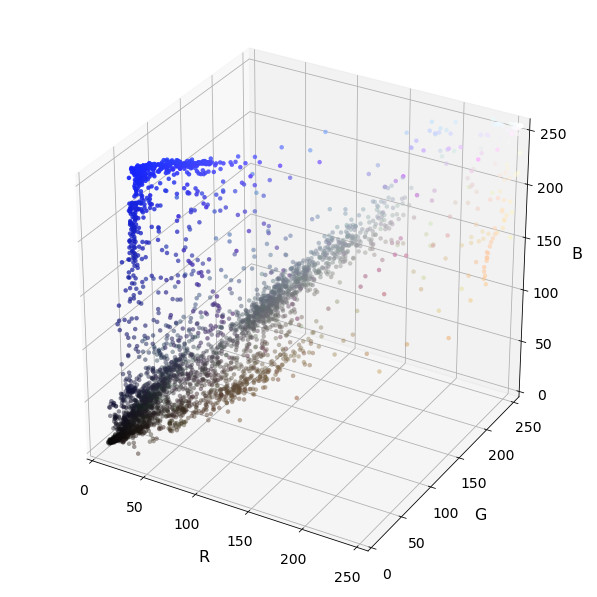

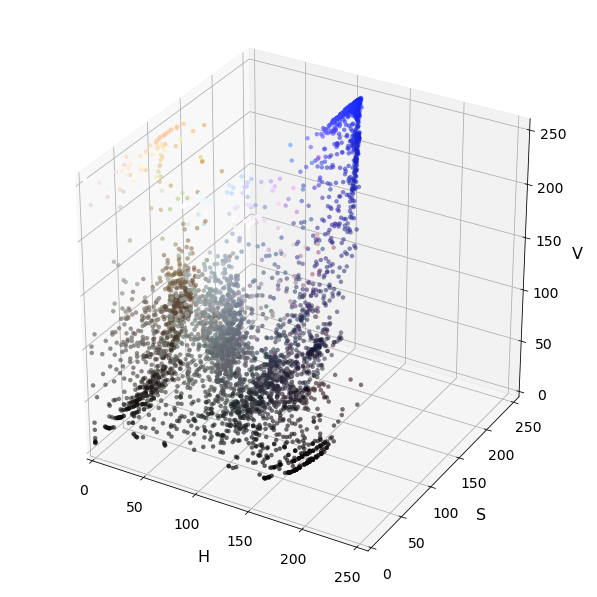

In [253]:
# Select a small fraction of pixels to plot by subsampling it
scale = max(img.shape[0], img.shape[1], 64) / 64  # at most 64 rows and columns
img_small = cv2.resize(img, (np.int(img.shape[1] / scale), np.int(img.shape[0] / scale)), interpolation=cv2.INTER_NEAREST)

# Convert subsampled image to desired color space(s)
img_small_RGB = cv2.cvtColor(img_small, cv2.COLOR_BGR2RGB)  # OpenCV uses BGR, matplotlib likes RGB
img_small_HSV = cv2.cvtColor(img_small, cv2.COLOR_BGR2HSV)
img_small_rgb = img_small_RGB / 255.  # scaled to [0, 1], only for plotting

# Plot and show
plot3d(img_small_RGB, img_small_rgb)
plt.show()

plot3d(img_small_HSV, img_small_rgb, axis_labels=list("HSV"))
plt.show()

In [274]:
test_imgs = np.stack(read_imgs(X_train_vehicle_files[:10], scale_to_255=True))
test_imgs.reshape((-1, 3))[:,0].shape

(40960,)

In [268]:
read_img(X_train_vehicle_files[0])[:, 0].ravel().shape

(192,)

In [ ]:
read_img(X_train_vehicle_files[0], scale_to_255=True, apply_fnc=lambda x: cv2.cvtColor(x, cv2.COLOR_RGB2HSV))

In [344]:
def plot3d_multiple_imgs(img_files, fig, axis_labels=list("RGB"),  
                         axis_limits=((0, 255), (0, 255), (0, 255)),
                         apply_fnc=None, row=1, col=1, idx=1, title=None):
    """Plot pixels in 3D."""

    # Create figure and 3D axes
    ax = fig.add_subplot(row, col, idx, projection='3d')
    
    if title is not None:
        ax.set_title(title)

    # Set axis limits
    ax.set_xlim(*axis_limits[0])
    ax.set_ylim(*axis_limits[1])
    ax.set_zlim(*axis_limits[2])

    # Set axis labels and sizes
    ax.tick_params(axis='both', which='major', labelsize=14, pad=8)
    ax.set_xlabel(axis_labels[0], fontsize=16, labelpad=16)
    ax.set_ylabel(axis_labels[1], fontsize=16, labelpad=16)
    ax.set_zlabel(axis_labels[2], fontsize=16, labelpad=16)
    
    pixels = np.stack(read_imgs(img_files, scale_to_255=True, apply_fnc=apply_fnc)).reshape((-1, 3))
    idx = list(range(pixels.shape[0]))
    random.shuffle(idx)
    idx = idx[:4096]
    pixels = pixels[idx]

    # Plot pixel values with colors given in colors_rgb
    ax.scatter(
        pixels[:, 0].ravel(),
        pixels[:, 1].ravel(),
        pixels[:, 2].ravel(),
        edgecolors='none')

    return ax  # return Axes3D object for further manipulation

In [ ]:
            if cspace == 'HSV':
                feature_img = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif cspace == 'LUV':
                feature_img = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif cspace == 'HLS':
                feature_img = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif cspace == 'YUV':
                feature_img = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)

### RGB

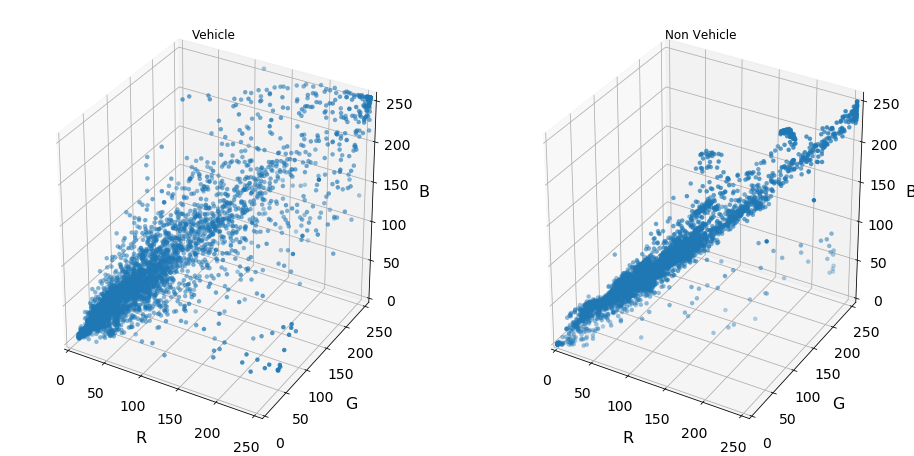

In [345]:
fig = plt.figure(figsize=(16,8))
plot3d_multiple_imgs(X_train_vehicle_files[:20], fig, row=1, col=2, idx=1, title='Vehicle')
plot3d_multiple_imgs(X_train_nonvehicle_files[:20], fig, row=1, col=2, idx=2, title='Non Vehicle')
plt.show()

### HSV

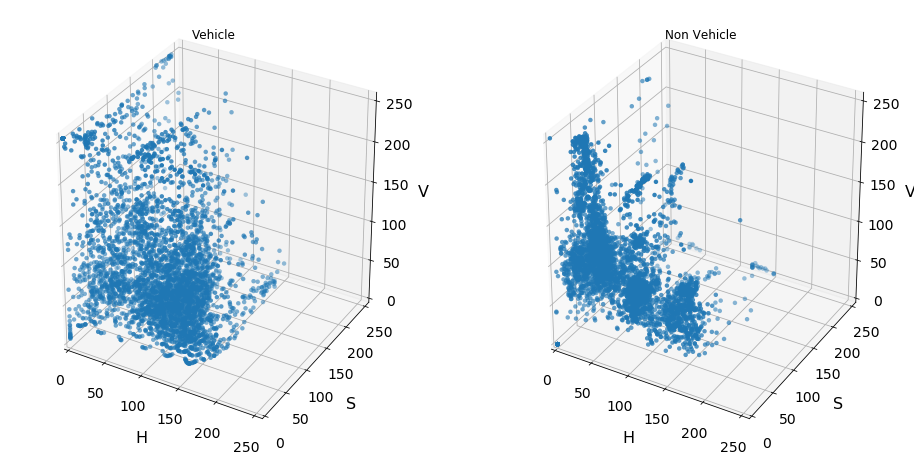

In [346]:
fig = plt.figure(figsize=(16,8))
plot3d_multiple_imgs(X_train_vehicle_files[:20], fig, row=1, col=2, idx=1, axis_labels=list("HSV"),
                     apply_fnc=lambda x: cv2.cvtColor(x, cv2.COLOR_RGB2HSV), title='Vehicle')
plot3d_multiple_imgs(X_train_nonvehicle_files[:20], fig, row=1, col=2, idx=2, axis_labels=list("HSV"),
                     apply_fnc=lambda x: cv2.cvtColor(x, cv2.COLOR_RGB2HSV), title='Non Vehicle')
plt.show()

### LUV

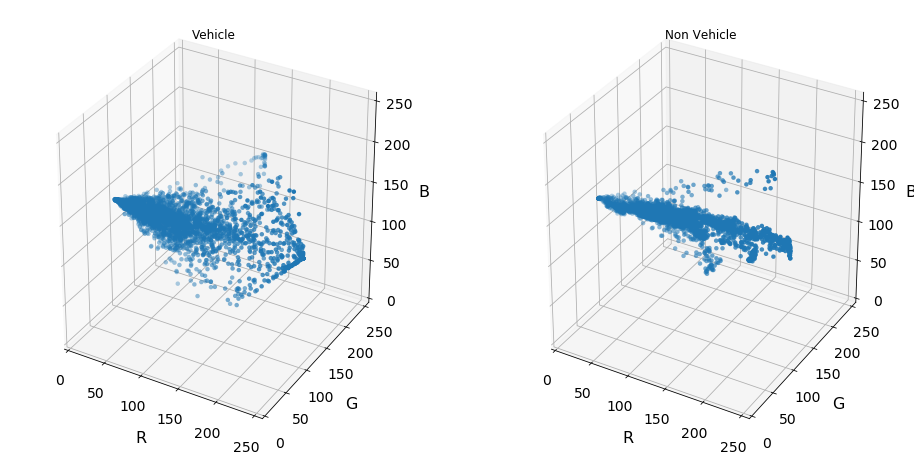

In [348]:
fig = plt.figure(figsize=(16,8))
plot3d_multiple_imgs(X_train_vehicle_files[:20], fig, row=1, col=2, idx=1, 
                     apply_fnc=lambda x: cv2.cvtColor(x, cv2.COLOR_RGB2LUV), title='Vehicle')
plot3d_multiple_imgs(X_train_nonvehicle_files[:20], fig, row=1, col=2, idx=2, 
                     apply_fnc=lambda x: cv2.cvtColor(x, cv2.COLOR_RGB2LUV), title='Non Vehicle')
plt.show()

### HLS

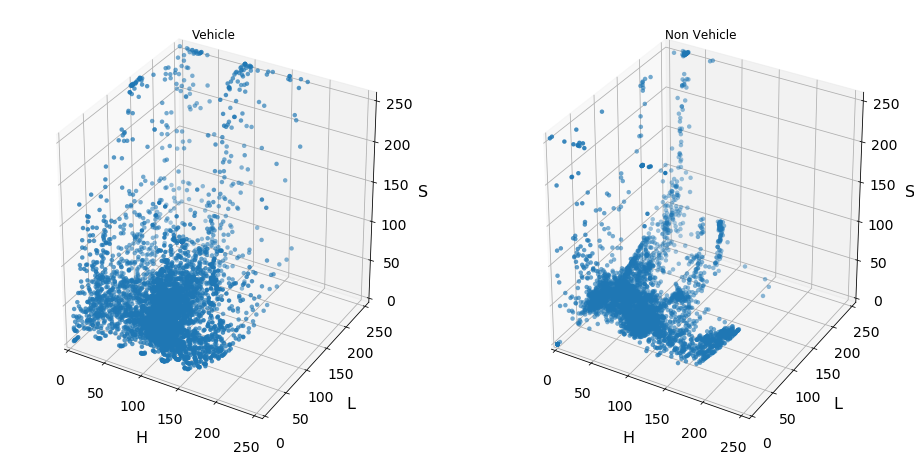

In [347]:
fig = plt.figure(figsize=(16,8))
plot3d_multiple_imgs(X_train_vehicle_files[:20], fig, row=1, col=2, idx=1, axis_labels=list("HLS"),
                     apply_fnc=lambda x: cv2.cvtColor(x, cv2.COLOR_RGB2HLS), title='Vehicle')
plot3d_multiple_imgs(X_train_nonvehicle_files[:20], fig, row=1, col=2, idx=2, axis_labels=list("HLS"),
                     apply_fnc=lambda x: cv2.cvtColor(x, cv2.COLOR_RGB2HLS), title='Non Vehicle')
plt.show()

### YUV

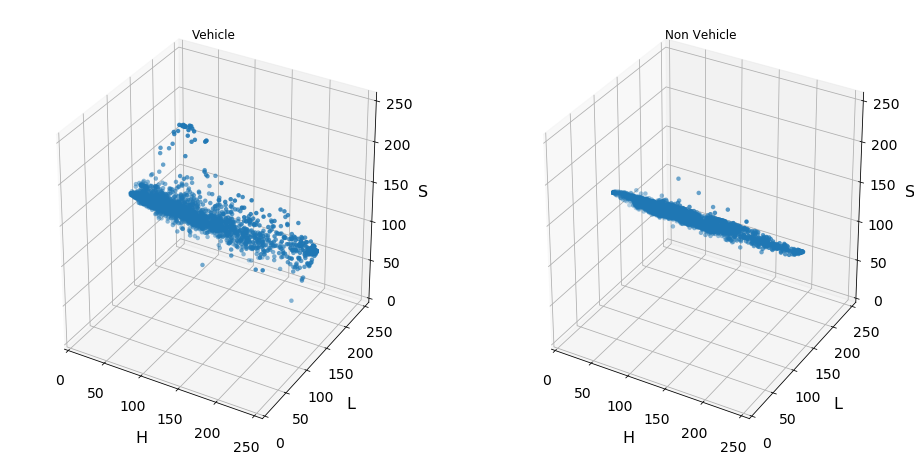

In [349]:
fig = plt.figure(figsize=(16,8))
plot3d_multiple_imgs(X_train_vehicle_files[:20], fig, row=1, col=2, idx=1, axis_labels=list("HLS"),
                     apply_fnc=lambda x: cv2.cvtColor(x, cv2.COLOR_RGB2YUV), title='Vehicle')
plot3d_multiple_imgs(X_train_nonvehicle_files[:20], fig, row=1, col=2, idx=2, axis_labels=list("HLS"),
                     apply_fnc=lambda x: cv2.cvtColor(x, cv2.COLOR_RGB2YUV), title='Non Vehicle')
plt.show()

In [254]:
def bin_spatial(img, size=(32, 32)):
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(img, size).ravel() 
    # Return the feature vector
    return features

# HOG

In [350]:
def get_hog_features(img, orient, pix_per_cell, cell_per_block, visualize=False):
    return hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                   cells_per_block=(cell_per_block, cell_per_block), block_norm= 'L2-Hys',
                   transform_sqrt=True, visualise=visualize, feature_vector=True)

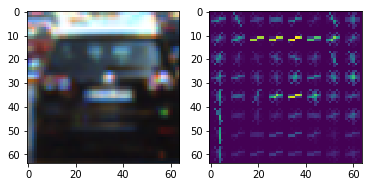

In [351]:
img = read_img(X_train_vehicle_files[1], scale_to_255=True)
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# Call our function with vis=True to see an image output
features, hog_img = get_hog_features(gray, orient= 9, pix_per_cell= 8, cell_per_block= 2, visualize=True)

plt.subplot(1,2,1)
plt.imshow(img)
plt.subplot(1,2,2)
plt.imshow(hog_img)
plt.show()

In [361]:
def make_scalers(img_files, cspace='RGB', spatial_size=(32, 32), hist_bins=32, hist_range=(0, 256), 
                 hog_orient=9, hog_pix_per_cell=8, hog_cell_per_block=2, scale_to_255=True):
    spatial_feature_arr = []
    hist_feature_arr = []
    hog_feature_arrs = [[], [], []]
    
    for img_file in tqdm(img_files):
        img = read_img(img_file, scale_to_255=scale_to_255)
        # apply color conversion if other than 'RGB'
        if cspace != 'RGB':
            if cspace == 'HSV':
                feature_img = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif cspace == 'LUV':
                feature_img = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif cspace == 'HLS':
                feature_img = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif cspace == 'YUV':
                feature_img = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
        else: 
            feature_img = np.copy(img) 
            
        spatial_features = bin_spatial(feature_img, size=spatial_size)
        spatial_feature_arr.append(spatial_features)
        
        hist_features = color_hist(feature_img, nbins=hist_bins, bins_range=hist_range)
        hist_feature_arr.append(hist_features)
        
        for i in range(3):
            hog_features = get_hog_features(feature_img[:,:,i], orient=hog_orient, pix_per_cell=hog_pix_per_cell, 
                                            cell_per_block=hog_cell_per_block)
            hog_feature_arrs[i].append(hog_features)

    spatial_feature_scaler = StandardScaler()
    hist_feature_scaler = StandardScaler()
    hog_feature_scalers = [StandardScaler() for i in range(3)]
    
    spatial_feature_scaler.fit(np.array(spatial_feature_arr).reshape((-1,1)))
    hist_feature_scaler.fit(np.array(hist_feature_arr).reshape((-1,1)))
    for i in range(3):
        hog_feature_scalers[i].fit(np.array(hog_feature_arrs[i]).reshape((-1,1)))
    
    return spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers

In [362]:
X_train_img_files, y_train = shuffle_train_data(X_train_img_files, y_train)

In [365]:
num_of_samples = int(0.05*len(y_train))
_X_train_img_files = X_train_img_files[:num_of_samples]
_y_train = y_train[:num_of_samples]

In [403]:
cspace='RGB'

In [404]:
spatial_feature_scaler, hist_feature_scaler, \
    hog_feature_scalers = make_scalers(_X_train_img_files, cspace=cspace, spatial_size=(32, 32), 
                                       hist_bins=32, hist_range=(0, 256), 
                                       hog_orient=9, hog_pix_per_cell=8, hog_cell_per_block=2, scale_to_255=True)

100%|███████████████████████████████████████████████████████████████████████████████| 621/621 [00:02<00:00, 207.14it/s]
C:\Users\ekkus93\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\ekkus93\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype int64 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


In [405]:
img = read_img(X_train_img_files[1], scale_to_255=True)
feature_img = np.copy(img) 

spatial_size=(32, 32)
spatial_features = bin_spatial(feature_img, size=spatial_size)

hist_bins=32
hist_range=(0, 256)
hist_features = color_hist(feature_img, nbins=hist_bins, bins_range=hist_range)

hog_orient=9
hog_pix_per_cell=8
hog_cell_per_block=2
hog_features = get_hog_features(feature_img[:,:,0], orient=hog_orient, pix_per_cell=hog_pix_per_cell, 
                                cell_per_block=hog_cell_per_block)

In [406]:
spatial_feature_scaler.mean_
scaled_spatial_features = spatial_feature_scaler.transform([spatial_features])
print(spatial_features.min(), spatial_features.max())
print(scaled_spatial_features.min(), scaled_spatial_features.max())
print(spatial_features.shape, scaled_spatial_features.shape)

22 119
-1.10456868136 0.664409711778
(3072,) (1, 3072)


In [407]:
hist_feature_scaler.mean_
scaled_hist_features = hist_feature_scaler.transform([hist_features])
print(hist_features.min(), hist_features.max())
print(scaled_hist_features.min(), scaled_hist_features.max())
print(hist_features.shape, scaled_hist_features.shape)

0 2078
-0.52612446306 8.01517736693
(96,) (1, 96)


In [408]:
hog_feature_scalers[0].mean_
scaled_hog_features = hog_feature_scalers[0].transform([hog_features])
print(hog_features.min(), hog_features.max())
print(scaled_hog_features.min(), scaled_hog_features.max())
print(hog_features.shape, scaled_hog_features.shape)

0.0 4.29163020226
-0.467342596351 5.41897179872
(1764,) (1, 1764)


In [409]:
def extract_features(img_files, spatial_feature_scaler=None, hist_feature_scaler=None, hog_feature_scalers=None, 
                     color_space='RGB', spatial_size=(32, 32), hist_bins=32, hist_range=(0, 256), 
                     hog_orient=9, hog_pix_per_cell=8, hog_cell_per_block=2, scale_to_255=True):
    # make sure that there's is one set of features being used
    bool_scalers = [False if x is None else True for x in [spatial_feature_scaler, hist_feature_scaler, 
                                                           hog_feature_scalers]]
    assert np.array(bool_scalers).astype(np.uint8).sum() > 0
    
    # Create a list to append feature vectors to
    features = []
    
    # Iterate through the list of images
    for img_file in tqdm(img_files):
        img = read_img(img_file, scale_to_255=scale_to_255)
        
        # apply color conversion if other than 'RGB'
        if color_space != 'RGB':
            if color_space == 'HSV':
                feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
            elif color_space == 'LUV':
                feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
            elif color_space == 'HLS':
                feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
            elif color_space == 'YUV':
                feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
        else: 
            feature_image = np.copy(image)  
            
        curr_features_arr = []
            
        if spatial_feature_scaler is not None:
            # Apply bin_spatial() to get spatial color features
            spatial_features = bin_spatial(feature_image, size=spatial_size)
            spatial_features = spatial_feature_scaler.transform([spatial_features])[0]
            curr_features_arr.append(spatial_features)
            
        if hist_feature_scaler is not None:
            # Apply color_hist() also with a color space option now
            hist_features = color_hist(feature_image, nbins=hist_bins, bins_range=hist_range)
            hist_features = hist_feature_scaler.transform([hist_features])[0]
            curr_features_arr.append(hist_features)
        
        if hog_feature_scalers is not None:
            hog_features_arr = []
            for i in range(3):
                hog_features = get_hog_features(feature_image[:,:,i], orient=hog_orient, pix_per_cell=hog_pix_per_cell, 
                                            cell_per_block=hog_cell_per_block)
                hog_features_arr.append(hog_features)
            hog_features_np = np.concatenate(hog_features_arr)
            curr_features_arr.append(hog_features_np)
                   
        if len(curr_features_arr) == 1:
            curr_features = curr_features_arr[0]
        else:
            curr_features = np.concatenate(curr_features_arr)
        features.append(curr_features)
        
    # Return list of feature vectors
    return features

In [410]:
X_train = extract_features(X_train_img_files[:2], spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers,
                           color_space=cspace, spatial_size=(32, 32), hist_bins=32, hist_range=(0, 256), 
                           scale_to_255=True, hog_orient=9, hog_pix_per_cell=8, hog_cell_per_block=2)

100%|████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:02<00:00,  1.11s/it]


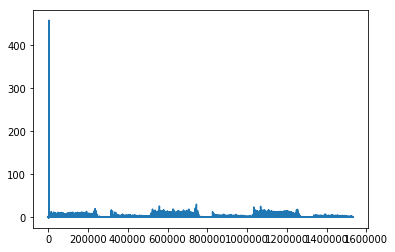

In [411]:
plt.plot(X_train[0])
plt.show()

In [412]:
X_train[0].min(), X_train[0].max(), X_train[0].mean()

(-1.505780275676829, 458.59967650402365, 1.3918508253427282)

# Train 

## SVM

In [413]:
parameters = {'kernel':('linear', 'rbf'), 'C':list(range(1,10,3))}
n_jobs = 8

svr = svm.SVC()
clf = GridSearchCV(svr, parameters, verbose=2, n_jobs=n_jobs)

In [417]:
X_train_img_files, y_train = shuffle_train_data(X_train_img_files, y_train)

In [418]:
X_train = extract_features(X_train_img_files, spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers,
                           color_space=cspace, spatial_size=(32, 32), hist_bins=32, hist_range=(0, 256), 
                           scale_to_255=True, hog_orient=9, hog_pix_per_cell=8, hog_cell_per_block=2)


  0%|                                                                              | 8/12432 [00:08<3:48:42,  1.10s/it]
Exception in thread Thread-23:
Traceback (most recent call last):
  File "C:\Users\ekkus93\AppData\Local\conda\conda\envs\tensorflow\lib\threading.py", line 914, in _bootstrap_inner
    self.run()
  File "C:\Users\ekkus93\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\tqdm\_tqdm.py", line 144, in run
    for instance in self.tqdm_cls._instances:
  File "C:\Users\ekkus93\AppData\Local\conda\conda\envs\tensorflow\lib\_weakrefset.py", line 60, in __iter__
    for itemref in self.data:
RuntimeError: Set changed size during iteration

  0%|                                                                             | 10/12432 [00:11<3:49:18,  1.11s/it]


KeyboardInterrupt: 

In [386]:
num_of_samples = int(0.1*len(y_train))
_X_train = X_train[:num_of_samples]
_y_train = y_train[:num_of_samples]

In [387]:
y_train[:10]

[1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0]

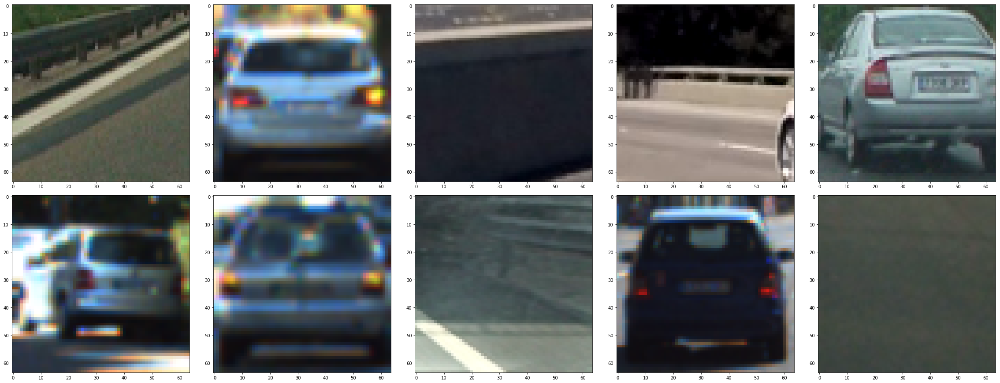

In [416]:
display_images(X_train_img_files, start_idx=0, end_idx=10,  step_val=1,
                   columns = 5, use_gray=False,
                   apply_fnc=lambda x: read_img(x, scale_to_255=True), figsize=(32,18))

In [389]:
clf.fit(_X_train, _y_train)

Fitting 3 folds for each of 6 candidates, totalling 18 fits


[Parallel(n_jobs=8)]: Done  13 out of  18 | elapsed:   24.3s remaining:    9.3s
[Parallel(n_jobs=8)]: Done  18 out of  18 | elapsed:   32.4s finished


GridSearchCV(cv=None, error_score='raise',
       estimator=SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False),
       fit_params=None, iid=True, n_jobs=8,
       param_grid={'C': [1, 4, 7], 'kernel': ('linear', 'rbf')},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=2)

In [390]:
clf.best_estimator_

SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='linear',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [391]:
clf.cv_results_ 

C:\Users\ekkus93\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\sklearn\utils\deprecation.py:122: FutureWarning: You are accessing a training score ('mean_train_score'), which will not be available by default any more in 0.21. If you need training scores, please set return_train_score=True
  warnings.warn(*warn_args, **warn_kwargs)
C:\Users\ekkus93\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\sklearn\utils\deprecation.py:122: FutureWarning: You are accessing a training score ('split0_train_score'), which will not be available by default any more in 0.21. If you need training scores, please set return_train_score=True
  warnings.warn(*warn_args, **warn_kwargs)
C:\Users\ekkus93\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\sklearn\utils\deprecation.py:122: FutureWarning: You are accessing a training score ('split1_train_score'), which will not be available by default any more in 0.21. If you need training scores, please set return_train_score=Tru

{'mean_fit_time': array([ 1.62766925,  8.89600269,  2.1750021 ,  8.98833458,  2.10366797,
         6.71300117]),
 'mean_score_time': array([ 0.97999867,  3.5090011 ,  1.08000032,  3.40033285,  0.93866658,
         1.87299983]),
 'mean_test_score': array([ 0.96701529,  0.9388576 ,  0.96701529,  0.94931617,  0.96701529,
         0.94931617]),
 'mean_train_score': array([ 1.        ,  0.99919533,  1.        ,  1.        ,  1.        ,  1.        ]),
 'param_C': masked_array(data = [1 1 4 4 7 7],
              mask = [False False False False False False],
        fill_value = ?),
 'param_kernel': masked_array(data = ['linear' 'rbf' 'linear' 'rbf' 'linear' 'rbf'],
              mask = [False False False False False False],
        fill_value = ?),
 'params': [{'C': 1, 'kernel': 'linear'},
  {'C': 1, 'kernel': 'rbf'},
  {'C': 4, 'kernel': 'linear'},
  {'C': 4, 'kernel': 'rbf'},
  {'C': 7, 'kernel': 'linear'},
  {'C': 7, 'kernel': 'rbf'}],
 'rank_test_score': array([1, 6, 1, 4, 1, 4]),
 'spli

In [392]:
clf.best_params_

{'C': 1, 'kernel': 'linear'}

In [393]:
X_val = extract_features(X_val_img_files, spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers,
                           color_space='YUV', spatial_size=(32, 32), hist_bins=32, hist_range=(0, 256), 
                           scale_to_255=True, hog_orient=9, hog_pix_per_cell=8, hog_cell_per_block=2)

100%|█████████████████████████████████████████████████████████████████████████████| 3569/3569 [00:18<00:00, 194.13it/s]


In [394]:
X_test = extract_features(X_test_img_files, spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers,
                           color_space='YUV', spatial_size=(32, 32), hist_bins=32, hist_range=(0, 256), 
                           scale_to_255=True, hog_orient=9, hog_pix_per_cell=8, hog_cell_per_block=2)

100%|█████████████████████████████████████████████████████████████████████████████| 1759/1759 [00:09<00:00, 193.85it/s]


In [395]:
type(X_test), type(y_test)

(list, list)

In [396]:
clf.score(X_val, y_val)

0.97226113757355004

In [397]:
clf.score(X_test, y_test)

0.96759522455940872

## Use best setting to fully train svm model

In [398]:
best_clf = svm.SVC(C=4, cache_size=200, class_weight=None, coef0=0.0,
                   decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
                   max_iter=-1, probability=False, random_state=None, shrinking=True,
                   tol=0.001, verbose=False)

In [399]:
best_clf.fit(X_train, y_train)

SVC(C=4, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [400]:
best_clf.score(X_val, y_val)

0.97001961333706921

In [401]:
best_clf.score(X_test, y_test)

0.97384877771461054

In [91]:
best_svm_file = '%s/best_svm.pkl' % data_dir

In [92]:
joblib.dump(best_clf, best_svm_file) 

['data/best_svm.pkl']

In [93]:
_best_clf = joblib.load(best_svm_file) 

# Search and Classify

In [94]:
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
        
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0]*(xy_overlap[0]))
    ny_buffer = np.int(xy_window[1]*(xy_overlap[1]))
    nx_windows = np.int((xspan-nx_buffer)/nx_pix_per_step) 
    ny_windows = np.int((yspan-ny_buffer)/ny_pix_per_step) 
    
    # Initialize a list to append window positions to
    window_list = []
    
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            print("### ys:", ys)
            print("### xs:", xs)
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            print("((%d, %d), (%d, %d))" % startx, endx)
            
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
            
    # Return the list of windows
    return window_list

In [95]:
def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
        
    # Return the image copy with boxes drawn
    return imcopy

In [230]:
# Define a function to extract features from a single image window
# This function is very similar to extract_features()
# just for a single image rather than list of images
def single_img_features(img, spatial_feature_scaler=None, hist_feature_scaler=None, hog_feature_scalers=None,
                        color_space='RGB', spatial_size=(32, 32), hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0):  
    # make sure that there's is one set of features being used
    bool_scalers = [False if x is None else True for x in [spatial_feature_scaler, hist_feature_scaler, 
                                                           hog_feature_scalers]]
    assert np.array(bool_scalers).astype(np.uint8).sum() > 0
    
    #1) Define an empty list to receive features
    img_features = []
    #2) Apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    else: 
        feature_image = np.copy(img)  
        
    curr_features_arr = []
    if spatial_feature_scaler is not None:
        # Apply bin_spatial() to get spatial color features
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        spatial_features = spatial_feature_scaler.transform([spatial_features])[0]
        curr_features_arr.append(spatial_features)
            
    if hist_feature_scaler is not None:
        # Apply color_hist() also with a color space option now
        hist_features = color_hist(feature_image, nbins=hist_bins, bins_range=hist_range)
        hist_features = hist_feature_scaler.transform([hist_features])[0]
        curr_features_arr.append(hist_features)
        
    if hog_feature_scalers is not None:
        hog_features_arr = []
        for i in range(3):
            hog_features = get_hog_features(feature_image[:,:,i], orient=hog_orient, pix_per_cell=hog_pix_per_cell, 
                                            cell_per_block=hog_cell_per_block)
            hog_features_arr.append(hog_features)
        hog_features_np = np.concatenate(hog_features_arr)     
        curr_features_arr.append(hog_features_np)
        
    if len(curr_features_arr) == 1:
        curr_features = curr_features_arr[0]
    else:
        curr_features = np.concatenate(curr_features_arr)
        
    return curr_features

# Define a function you will pass an image 
# and the list of windows to be searched (output of slide_windows())
def search_windows(img, windows, clf, 
                   spatial_feature_scaler=None, hist_feature_scaler=None, hog_feature_scalers=None,
                   color_space='RGB', spatial_size=(32, 32), hist_bins=32, 
                   hist_range=(0, 256), orient=9, pix_per_cell=8, cell_per_block=2):
    # make sure that there's is one set of features being used
    bool_scalers = [False if x is None else True for x in [spatial_feature_scaler, hist_feature_scaler, 
                                                           hog_feature_scalers]]
    assert np.array(bool_scalers).astype(np.uint8).sum() > 0    
    
    #1) Create an empty list to receive positive detection windows
    on_windows = []
    #2) Iterate over all windows in the list
    for window in windows:
        #3) Extract the test window from original image
        test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))      
        #4) Extract features for that window using single_img_features()
        features = single_img_features(test_img, spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers,
                                       color_space=color_space, spatial_size=spatial_size, hist_bins=hist_bins, 
                                       orient=orient, pix_per_cell=pix_per_cell, cell_per_block=cell_per_block)
        
        #5) Scale extracted features to be fed to classifier
        test_features = np.array(features).reshape(1, -1)
        
        #6) Predict using your classifier
        prediction = clf.predict(test_features)
        
        #7) If positive (prediction == 1) then save the window
        if prediction == 1:
            on_windows.append(window)
            
    #8) Return windows for positive detections
    return on_windows

In [201]:
### TODO: Tweak these parameters and see how the results change.
color_space = 'HLS'
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins=32 # Number of histogram bins
hist_range=(0, 256)
hog_orient=9 # HOG orientations
hog_pix_per_cell=8 # HOG pixels per cell
hog_cell_per_block=2 # HOG cells per block

y_start_stop = [300, None] # Min and max in y to search in slide_window()

In [202]:
image = read_img('test_images/test1.jpg', scale_to_255=False)
image.min(), image.max()

(0, 255)

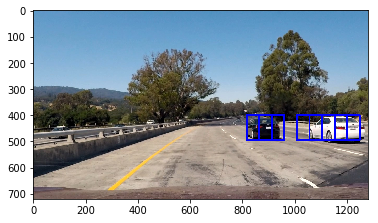

In [203]:
draw_image = np.copy(image)

# Uncomment the following line if you extracted training
# data from .png images (scaled 0 to 1 by mpimg) and the
# image you are searching is a .jpg (scaled 0 to 255)
#image = image.astype(np.float32)/255

windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop, 
                    xy_window=(96, 96), xy_overlap=(0.5, 0.5))

hot_windows = search_windows(image, windows, best_clf, 
                             spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers,
                             color_space=color_space, spatial_size=spatial_size, hist_bins=hist_bins, 
                             hist_range=hist_range, orient=hog_orient, 
                             pix_per_cell=hog_pix_per_cell, cell_per_block=hog_cell_per_block)

window_img = draw_boxes(draw_image, hot_windows, color=(0, 0, 255), thick=6)                    

plt.imshow(window_img)

# Multiple Detections & False Positives

In [204]:
def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

    # Return updated heatmap
    return heatmap# Iterate through list of bboxes
    
def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
    # Return the image
    return img

In [205]:
heat = np.zeros_like(image[:,:,0]).astype(np.float)

In [207]:
hot_windows

[((816, 400), (912, 496)),
 ((864, 400), (960, 496)),
 ((1008, 400), (1104, 496)),
 ((1056, 400), (1152, 496)),
 ((1104, 400), (1200, 496)),
 ((1152, 400), (1248, 496))]

0.0 2.0


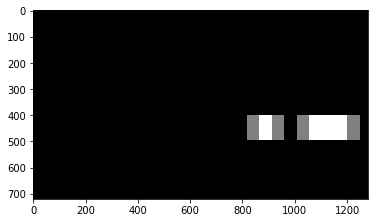

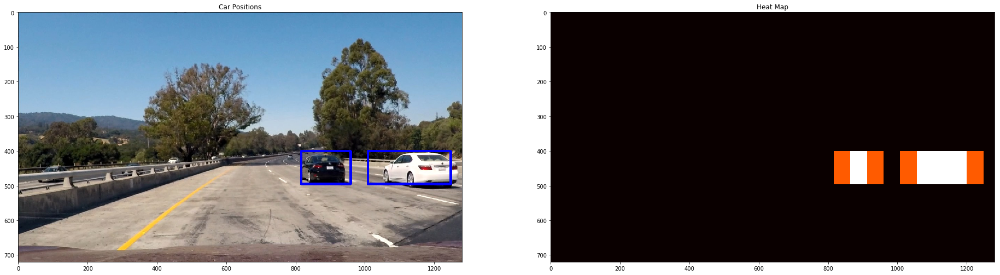

In [208]:
# Add heat to each box in box list
heat = add_heat(heat, hot_windows)
print(heat.min(), heat.max())

plt.imshow(heat, cmap='gray')
plt.show()

# Apply threshold to help remove false positives
heat = apply_threshold(heat,0)

# Visualize the heatmap when displaying    
heatmap = np.clip(heat, 0, 255)

# Find final boxes from heatmap using label function
labels = label(heatmap)
draw_img = draw_labeled_bboxes(np.copy(image), labels)

plt.figure(figsize=(32, 32))
plt.subplot(121)
plt.imshow(draw_img)
plt.title('Car Positions')
plt.subplot(122)
plt.imshow(heatmap, cmap='hot')
plt.title('Heat Map')
fig.tight_layout()

In [211]:
def get_labeled_img_with_heatmap(img, clf, spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers,
                                 x_start_stop=[None, None], y_start_stop=[400, None], 
                                 xy_window=(96, 96), xy_overlap=(0.5, 0.5),
                                 color_space = 'HLS', spatial_size = (32, 32), 
                                 hist_bins=32, hist_range=(0, 256), hog_orient=9, 
                                 hog_pix_per_cell=8, hog_cell_per_block=2, heat_threshold=0,
                                 hot_windows_arr=[], max_hot_windows=5):
    # make sure that there's is one set of features being used
    bool_scalers = [False if x is None else True for x in [spatial_feature_scaler, hist_feature_scaler, 
                                                           hog_feature_scalers]]
    assert np.array(bool_scalers).astype(np.uint8).sum() > 0    
    
    windows = slide_window(img, x_start_stop=x_start_stop, y_start_stop=y_start_stop, 
                            xy_window=xy_window, xy_overlap=xy_overlap)

    hot_windows = search_windows(img, windows, clf, 
                                 spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers,
                                 color_space=color_space, spatial_size=spatial_size, hist_bins=hist_bins, 
                                 hist_range=hist_range, orient=hog_orient, 
                                 pix_per_cell=hog_pix_per_cell, cell_per_block=hog_cell_per_block)  
    
    hot_windows_arr.append(hot_windows)
    if len(hot_windows_arr) > max_hot_windows:
        hot_windows_arr = hot_windows_arr[-max_hot_windows:]
        
    hot_windows = []
    for curr_hot_windows in hot_windows_arr:
        hot_windows += curr_hot_windows
    
    heat = np.zeros_like(img[:,:,0]).astype(np.float)
    
    # Add heat to each box in box list
    heat = add_heat(heat, hot_windows)

    # Apply threshold to help remove false positives
    heat = apply_threshold(heat,heat_threshold)

    # Visualize the heatmap when displaying    
    heatmap = np.clip(heat, 0, 255).astype(np.uint8)

    # Find final boxes from heatmap using label function
    labels = label(heatmap)
    draw_img = draw_labeled_bboxes(np.copy(img), labels)
    
    return draw_img, heatmap, hot_windows_arr

In [212]:
draw_img, heat_map, hot_windows_arr = get_labeled_img_with_heatmap(image, best_clf, 
                                                                   spatial_feature_scaler, hist_feature_scaler, 
                                                                   hog_feature_scalers,
                                                                   x_start_stop=[None, None], 
                                                                   y_start_stop=[400, None], 
                                                                   xy_window=(96, 96), xy_overlap=(0.5, 0.5),
                                                                   color_space = 'HLS', spatial_size = (32, 32), 
                                                                   hist_bins=32, hist_range=(0, 256), hog_orient=9, 
                                                                   hog_pix_per_cell=8, hog_cell_per_block=2)

In [213]:
draw_img.dtype, draw_img.min(), draw_img.max()

(dtype('uint8'), 0, 255)

In [214]:
heat_map.dtype, heat_map.min(), heat_map.max()

(dtype('uint8'), 0, 2)

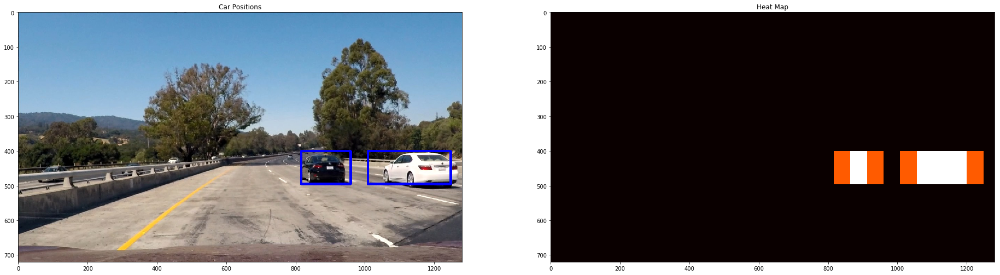

In [215]:
plt.figure(figsize=(32, 32))
plt.subplot(121)
plt.imshow(draw_img)
plt.title('Car Positions')
plt.subplot(122)
plt.imshow(heatmap, cmap='hot')
plt.title('Heat Map')
fig.tight_layout()
plt.show()

In [216]:
len(project_img_files)

1248

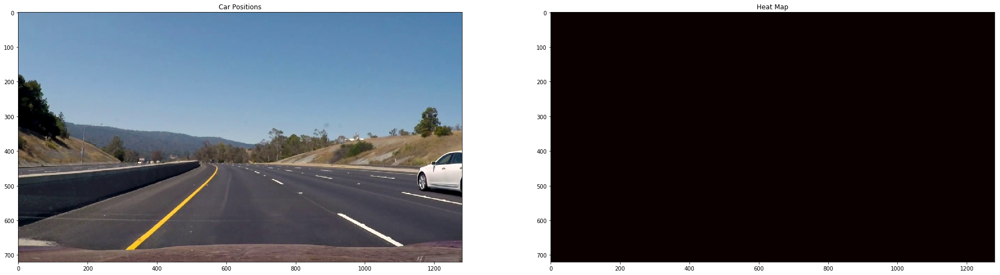

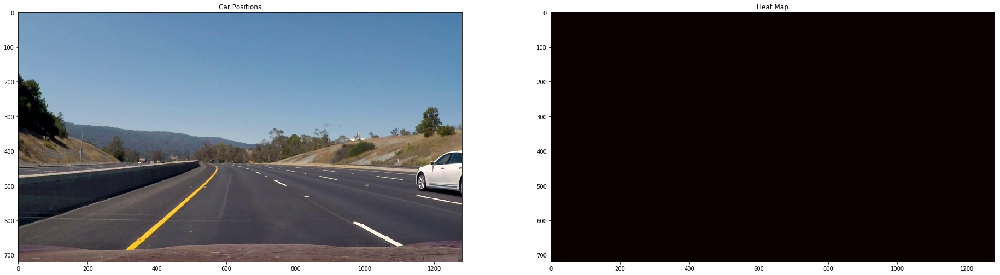

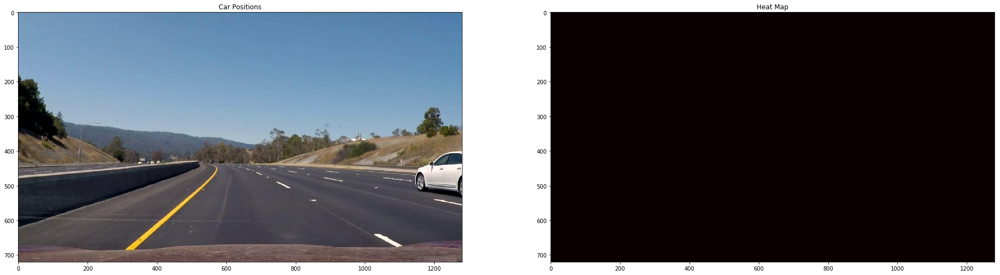

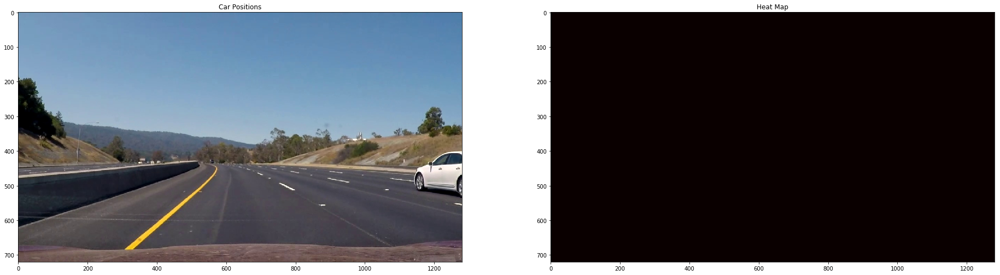

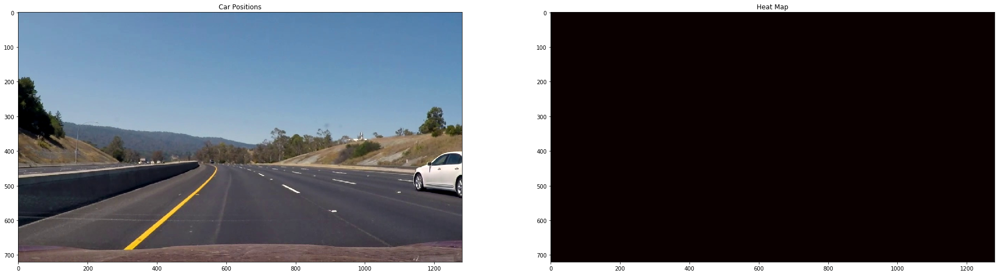

...

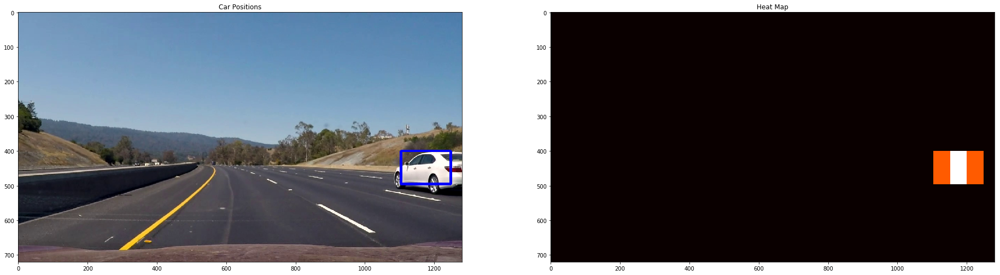

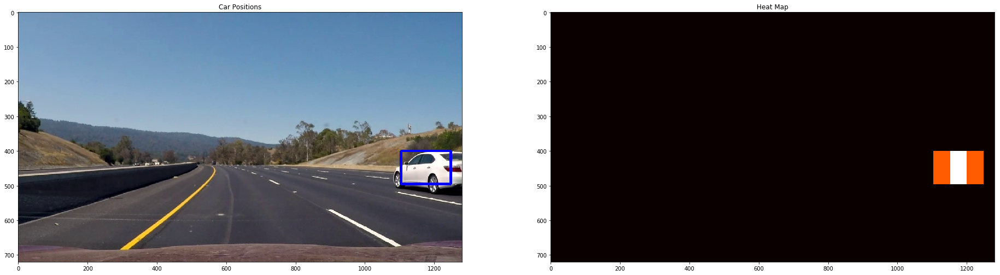

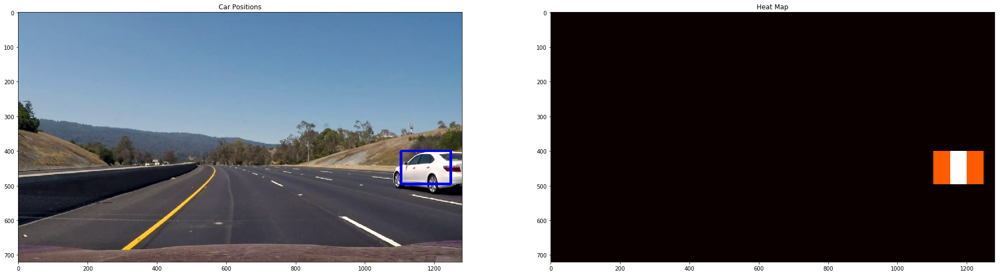

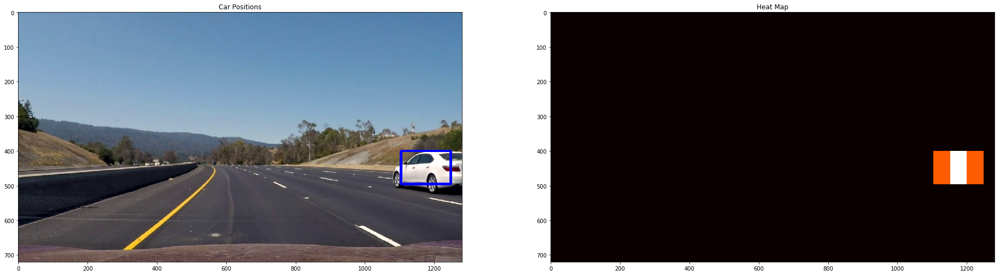

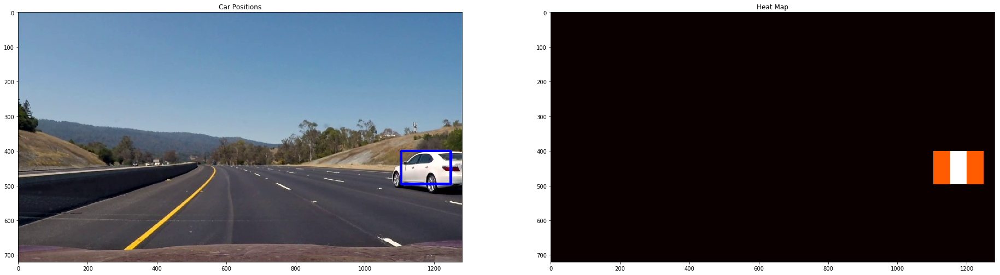

In [223]:
draw_img_arr = []
heat_map_arr = []
hot_windows_arr = []

#for img_file in project_img_files[:10]:
for i in range(154,194):
    img_file = project_img_files[i]
    img = read_img(img_file, scale_to_255=False)
    
    draw_img, heat_map, hot_windows_arr = get_labeled_img_with_heatmap(img, best_clf, 
                                                                       spatial_feature_scaler, hist_feature_scaler, 
                                                                       hog_feature_scalers,
                                                                       x_start_stop=[None, None], 
                                                                       y_start_stop=[400, None], 
                                                                       xy_window=(96, 96), xy_overlap=(0.5, 0.5),
                                                                       color_space = 'HLS', spatial_size = (32, 32), 
                                                                       hist_bins=32, hist_range=(0, 256), hog_orient=9, 
                                                                       hog_pix_per_cell=8, hog_cell_per_block=2,
                                                                       hot_windows_arr=hot_windows_arr, 
                                                                       max_hot_windows=1)
    
    draw_img_arr.append(draw_img)
    heat_map_arr.append(heat_map)
    
    plt.figure(figsize=(32, 32))
    plt.subplot(121)
    plt.imshow(draw_img)
    plt.title('Car Positions')
    plt.subplot(122)
    plt.imshow(heat_map, cmap='hot')
    plt.title('Heat Map')
    fig.tight_layout()
    plt.show()

In [224]:
def generate_car_boxes(img_files, clf, spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers, output_dir,
                       x_start_stop=[None, None], y_start_stop=[400, None],
                       xy_window=(96, 96), xy_overlap=(0.5, 0.5),
                       color_space = 'HLS', spatial_size = (32, 32), 
                       hist_bins=32, hist_range=(0, 256), hog_orient=9, 
                       hog_pix_per_cell=8, hog_cell_per_block=2):
    # make sure that there's is one set of features being used
    bool_scalers = [False if x is None else True for x in [spatial_feature_scaler, hist_feature_scaler, 
                                                           hog_feature_scalers]]
    assert np.array(bool_scalers).astype(np.uint8).sum() > 0    
    
    os.makedirs(output_dir, exist_ok=True)
    draw_dir = '%s/draw_imgs' % output_dir
    os.makedirs(draw_dir, exist_ok=True)
    heat_map_dir = '%s/heat_maps' % output_dir
    os.makedirs(heat_map_dir, exist_ok=True)
    
    hot_windows_arr = []
    
    for i, img_file in enumerate(img_files):
        img_file = project_img_files[i]
        img = read_img(img_file, scale_to_255=False)
    
        draw_img, heat_map, hot_windows_arr = get_labeled_img_with_heatmap(img, best_clf, spatial_feature_scaler, 
                                                                           hist_feature_scaler, hog_feature_scalers,
                                                                           x_start_stop=x_start_stop,
                                                                           y_start_stop=y_start_stop, 
                                                                           xy_window=xy_window, xy_overlap=xy_overlap,
                                                                           color_space=color_space, 
                                                                           spatial_size = spatial_size, 
                                                                           hist_bins=hist_bins, 
                                                                           hist_range=hist_range, 
                                                                           hog_orient=hog_orient,
                                                                           hog_pix_per_cell=hog_pix_per_cell, 
                                                                           hog_cell_per_block=hog_cell_per_block,
                                                                           hot_windows_arr=hot_windows_arr, 
                                                                           max_hot_windows=1)
        
        draw_img_file = '%s/draw_%s.png' % (draw_dir, pad_zeros(i))
        heat_map_file = '%s/heat_map_%s.png' % (heat_map_dir, pad_zeros(i))
        
        imsave(draw_img_file, draw_img)
        imsave(heat_map_file, heat_map)

In [227]:
output_dir = '%s/car_boxes' % data_dir
generate_car_boxes(project_img_files, best_clf, 
                   spatial_feature_scaler, hist_feature_scaler, hog_feature_scalers, output_dir)

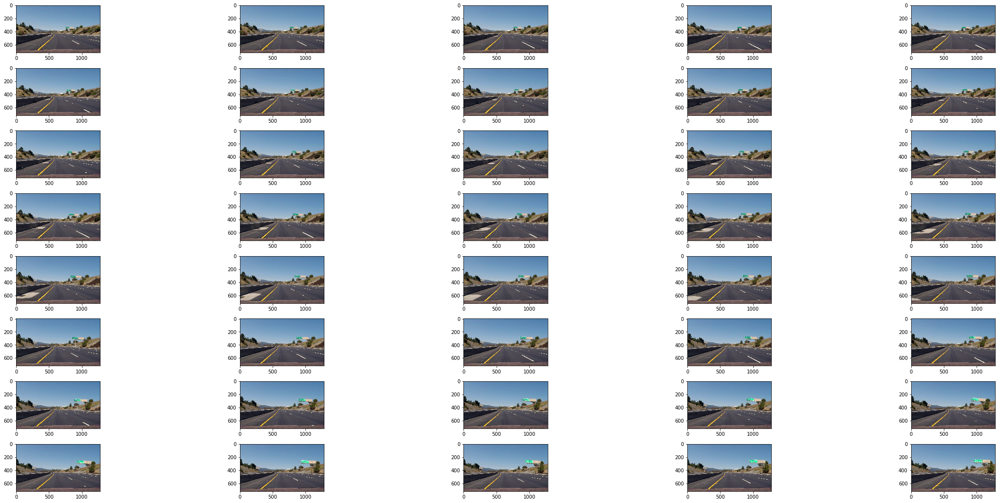

In [231]:
display_images(read_imgs(['data/car_boxes/draw_imgs/draw_%s.png' % pad_zeros(i) for i in range(40)]), figsize=(32,16))

In [11]:
read_img(project_img_files[0], scale_to_255=True).shape

(720, 1280, 3)